# Отчет о запусках
---

## Прогон коллекций данных

Подгрузим инструментарий.

In [1]:
# Основные библиотеки для работы с данными
import pandas as pd
import numpy as np
import joblib

# Полезные модули sklearn
from sklearn import manifold
from sklearn import cluster
from sklearn import metrics
from sklearn import decomposition

# Визуализация
import matplotlib.pyplot as plt
import seaborn as sns

# Progress bar
from tqdm import tqdm

# Функции из специального модуля
from useful_features import get_runs_report3
from useful_features import get_data_homogeneity_report
from useful_features import read_omg_csv, get_target

In [2]:
# Подгрузим метаданные
df_meta = pd.read_csv('./data/data_from_4_pilots/meta_information.csv', index_col=0)
# Сохраним вектор наименований файлов
fils = df_meta['montage'].apply(lambda x: x.split('.')[0]).values
# Сохраним вектор лейблов id пилотов
pilotes = df_meta['pilote_id'].values
# Выведем число коллекций данных и голову таблицы метаданных
print('Number of datasets:', df_meta.shape[0])
df_meta.head(2)

Number of datasets: 31


,montage,pilote_id,last_train_idx,len(train),len(test)
0,2023-05-15_16-16-08.palm,1,23337,23337,5810
1,2023-05-15_17-12-24.palm,1,23336,23336,5803


Воспользуемся функцией `get_runs_report3` из самописного модуля `useful_features`, чтобы рассчитать: 
- значения корреляции между таргетом и данными `Corr`, после исправления сдвига;
- значения корреляции между таргетом и данными в начале `corr_a` и в конце `corr_b` данных, рассчитанные при исправлении сдвига;
- значения F-меры для тестовых выборок: срдневзвешенной `f1_test` и отдельно по каждому жесту.

Расчет метрик F1 производится на предсказаниях 20 разнообразных алгоритмов классификации. В итоге мы получим 3d-массив данных, по первой оси которого можно будет получить доступ к отчету о запусках для конкретной модели. 

In [3]:
# %%time
# Получить отчет по запускам
# runs_reports, models = get_runs_report3(df_meta)

Models processed: 100%|██████████| 20/20 [11:43:42<00:00, 2111.14s/it]  

CPU times: total: 22h 24min 5s
Wall time: 11h 43min 42s


Код проработал почти 12 часов. Разумеется, имеет смысл сохранить получившийся результат в файл.

In [3]:
# Если требуется подгрузить массив полученных ранее результатов 
runs_reports = np.load('derivatives/reports.npy')

# Сохраняем список моделей в файл
# joblib.dump(models, 'derivatives/models_list.pkl')

# Загружаем список моделей обратно из файла
loaded_models = joblib.load('derivatives/models_list.pkl')

Далее по выбранному номеру модели в списке использованных алгоритмов мы можем получить доступ к соответствующему отчету.

In [4]:
# Выбор номера модели в списке
i=20
print('Отчет по алгоритму:')
# print(models[i])
print(loaded_models[i-1])

# Соберем таблицу отчета
report = pd.DataFrame(
    data=np.hstack(
        (fils.reshape(-1, 1),
         pilotes.reshape(-1, 1),
         np.round(runs_reports[i-1], 6))),
    columns=[
        'file', 'pilote_id', 'Corr', 'corr_a', 'corr_b', 'f1_test',
        'Neutral', 'Open', 'Pistol', 'Thumb', 'OK', 'Grab']
)

# Разукрасим таблицуу для облегчения восприятия
report.style.background_gradient(
    cmap='coolwarm',
    vmin=0, vmax=1,
    subset=list(report.columns)[2:]
)

Отчет по алгоритму:


,file,pilote_id,Corr,corr_a,corr_b,f1_test,Neutral,Open,Pistol,Thumb,OK,Grab
0,2023-05-15_16-16-08,1,0.274356,0.412871,0.256877,0.833128,0.902053,0.919192,0.641727,0.307978,0.779570,0.897368
1,2023-05-15_17-12-24,1,0.020546,0.191707,0.023858,0.636806,0.766574,0.801498,0.212488,0.068650,0.363144,0.572864
2,2023-06-05_16-12-38,1,0.341675,0.448190,0.339225,0.660268,0.818091,0.776025,0.271523,0.000000,0.560907,0.596623
3,2023-06-05_17-53-01,1,0.353172,0.264307,0.413203,0.746547,0.834416,0.785276,0.680973,0.373757,0.643200,0.644118
4,2023-06-20_14-43-11,1,0.083280,0.179436,0.182742,0.703648,0.811977,0.809892,0.452763,0.321569,0.633562,0.545151
5,2023-06-20_13-30-15,1,0.274443,0.235754,0.382149,0.753380,0.823946,0.830688,0.416510,0.519573,0.748538,0.776642
6,2023-06-20_12-34-17,1,0.361622,0.414341,0.356253,0.753033,0.846345,0.846154,0.692982,0.067183,0.714514,0.788945
7,2023-09-30_08-06-44,2,0.400822,0.443222,0.358299,0.907203,0.931129,0.882283,0.845927,0.946067,0.782946,0.913140
8,2023-09-29_11-03-50,2,0.346494,0.384182,0.456843,0.920865,0.936647,0.901176,0.922910,0.941950,0.840376,0.886878
9,2023-09-29_09-20-47,2,0.271879,0.363008,0.308670,0.924883,0.940181,0.897527,0.924319,0.915292,0.902386,0.877990


Характерная для многих алгоритмов проблема — описание классов Thumb, Pistol, OK и Grab для данных первого оператора. Еще особенно выделяются наборы данных с индексами 19, 23 и 29 — также проблемные для всех алгоритмов. Причиной этих проблем может быть качество данных. Один из специалистов Моторики сообщил, что определяющую роль в этом плане играет оборудование для получения данных.

Процесс исследования возможности протезирования имеет итеративный характер: забор данных — обучение модели — инференс — оценка качества — repit. Низкие метрики для некоторых наборов данных — нормальное явление. При дальнейшей работе их можно исключить из рассмотрения.

Попробуем исследовать наши метаданные на наличие интересных связей. Взглянем на корреляцию средневзвешенных F-мер со значениями корреляции таргетов и данных.

In [5]:
# Подготовим основу для 2d-массива отчетов
reports_2d = np.zeros((0, 10))
# Объединим в цикле все отчеты
for i in range(runs_reports.shape[0]):
    reports_2d = np.vstack((reports_2d, runs_reports[i]))

# Получаем матрицу корреляций
corr_matrix = np.corrcoef(reports_2d[:, :4].T)
matrix_frame = pd.DataFrame(
    corr_matrix,
    columns=list(report.columns)[2:6],
    index=list(report.columns)[2:6]
)
# Выводим тепловую карту
matrix_frame.style.background_gradient(
    cmap='coolwarm',
    vmin=0, vmax=1,
    subset=list(report.columns)[2:6]
)

,Corr,corr_a,corr_b,f1_test
Corr,1.000000,0.848688,0.899481,0.277545
corr_a,0.848688,1.000000,0.744442,0.192821
corr_b,0.899481,0.744442,1.000000,0.262424
f1_test,0.277545,0.192821,0.262424,1.000000


Как видим, корреляция имеется, но все же слабая.

Посмотрим также на график рассеяния F-мер в зависимости от значений общей корреляции данных со своими таргетами.

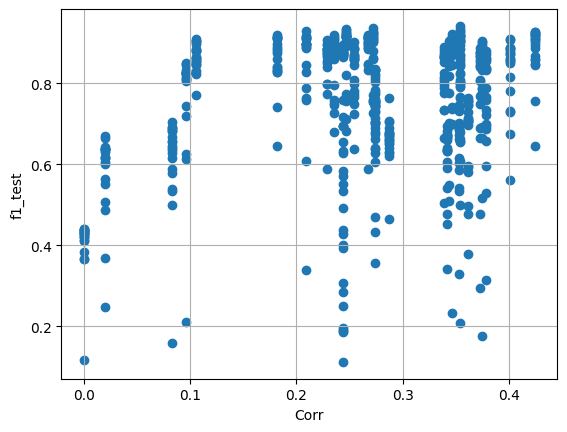

In [6]:
# Сформируем датафрейм из 2d-массива
reports_2d_df = pd.DataFrame(reports_2d, columns=list(report.columns[2:]))

# Выведем график
plt.scatter(reports_2d_df['Corr'], reports_2d_df['f1_test'])
plt.xlabel('Corr')
plt.ylabel('f1_test')
plt.grid()
plt.show()

Т.к. корреляции данных с целевыми значениями меняются лишь от набора к набору, а F-мера — от алгоритма к алгоритму, мы и наблюдаем *полосы*, в которые сливаются точки на графике. Похоже, мы можем визуально определить три кластера, но лучше доверить это дело алгоритмам.

Воспользуемся KMeans.

In [7]:
silhouette, calinski_harabasz, davies_bouldin = dict(), dict(), dict()
# Проходимся циклом по всем нужным нам значениям количества кластеров
for n in range(3, 20):
	# Обучаем модель k-means с текущим количеством кластеров
    km = cluster.KMeans(n_clusters=n, n_init=10, random_state=42).fit(reports_2d_df)
	# Выводим результат для коэффициента силуэта
    silhouette[n] = metrics.silhouette_score(reports_2d_df, km.labels_, metric='euclidean')
    calinski_harabasz[n] = metrics.calinski_harabasz_score(reports_2d_df, km.labels_)
    davies_bouldin[n] = metrics.davies_bouldin_score(reports_2d_df, km.labels_)

n_kl_silh = sorted(silhouette, key=lambda x: silhouette[x], reverse=True)[0]
print(f'Число кластеров с оптимальным коэффициентом силуэта: {n_kl_silh}, {round(silhouette[n_kl_silh], 2)}')
n_kl_ch = sorted(calinski_harabasz, key=lambda x: calinski_harabasz[x], reverse=True)[0]
print(f'Число кластеров с оптимальным индексом Калински-Харабаса: {n_kl_ch}, {round(calinski_harabasz[n_kl_ch], 2)}')
n_kl_db = sorted(davies_bouldin, key=lambda x: davies_bouldin[x])[0]
print(f'Число кластеров с оптимальным индексом Дэвиса-Болдина: {n_kl_db}, {round(davies_bouldin[n_kl_db], 2)}')

Число кластеров с оптимальным коэффициентом силуэта: 4, 0.39
Число кластеров с оптимальным индексом Калински-Харабаса: 3, 439.33
Число кластеров с оптимальным индексом Дэвиса-Болдина: 6, 1.13


Что ж, по одному из критериев три кластера — тоже оптимальный вариант.

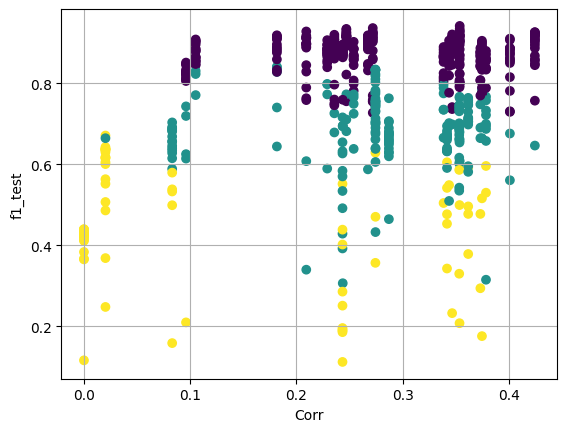

In [8]:
# Инициализируем объект
km_model = cluster.KMeans(
    n_clusters=3,
    random_state=42,
    n_init=10
)
# Обучение
km_model.fit(reports_2d_df)

plt.scatter(reports_2d_df['Corr'], reports_2d_df['f1_test'], c=km_model.labels_)
plt.xlabel('Corr')
plt.ylabel('f1_test')
plt.grid()
plt.show()

Получилось несколько контринтуитивно (по крайней мере, для меня).

Похоже, алгоритм нашел возможным объединить между собой множество точек из региона с низким F1. Правда, сепарация не столь строгая и некоторое множество зеленых точек затесалось между желтыми.

Для более обоснованных утверждений о схожести данных нам потребуется кластеризовать сами исходные данные, но это чуть позже.

Попробуем подвести итог раздела и выведем список сетов, на которых алгоритмам удавалось набрать 0.9 (регулируемый параметр) и более значения F1.

In [9]:
# Зададим порог отбора данных
threshold = 0.9

# Создадим словарь для подсчета
files_dict = dict.fromkeys(list(range(31)), 0)
# Пройдемся циклом по метаданным и посчитаем количество
# f1_test выше 0,9 для каждого набора данных
for i in range(runs_reports.shape[0]):
    for j in range(runs_reports.shape[1]):
        if runs_reports[i, j, 3] >= threshold:
            files_dict[j] += 1
            
# Сформируем таблицу
files_df = pd.DataFrame(
        data=np.hstack((
            fils.reshape(-1, 1),
            pilotes.reshape(-1, 1),
            np.array(list(files_dict.values())).reshape(-1, 1)
            )),
        columns=[
            'file', 'pilote_id','cnt'
        ]
    )
# Выведем список лучших данных
best_files = files_df.query("cnt != 0")
print(f'При пороге отбора {threshold} (F1-weighted)')
print(f'Число годных файлов с данными: {best_files.shape[0]}')
best_files

При пороге отбора 0.9 (F1-weighted)
Число годных файлов с данными: 15


,file,pilote_id,cnt
7,2023-09-30_08-06-44,2,2
8,2023-09-29_11-03-50,2,9
9,2023-09-29_09-20-47,2,11
12,2023-09-12_12-55-22,2,4
13,2023-05-31_17-14-41,2,1
14,2023-05-31_15-46-37,2,6
15,2023-05-22_20-22-01,2,11
16,2023-05-22_17-04-29,2,14
17,2023-05-19_12-04-02,2,6
18,2023-04-18_19-08-47 gestures train,3,1


В колонке `cnt` выводится число случаев превышения порога: т.е. чем выше число, тем чаще алгоритмам удавалось добиться значения метрики $f1-weighted$ выше заданного **threshold**.

Как видим, половина данных из имеющейся у нас коллекции пригодна для обучения качественных моделей. Однако среди них вовсе отсутствуют данные первого пилота.

---
## Исследование гомогенности выборок

Цель — проверить однородность данных в трейн и тест выборках во всех сетах.

In [11]:
# Подготовим пустой список для сбора средних значений
f1_test_means = []

# Посчитаем средние значения 20 (по числу алгоритмов)
# метрик для каждого набора данных
for i in range(runs_reports.shape[1]):
    f1_test_means.append(np.mean(runs_reports[:, i, 3]))

# Получим отчет о гомогенности данных
data_homogeneity_report = get_data_homogeneity_report(df_meta)

# Сконкатинируем датафреймы
data_homogeneity_report = pd.concat(
    [data_homogeneity_report, pd.DataFrame(f1_test_means, columns=['f1_mean'])],
    axis=1
)

# Разукрасим таблицу для облегчения восприятия
data_homogeneity_report.style.background_gradient(
    cmap='coolwarm',
    vmin=data_homogeneity_report.iloc[:, 2:].min().min(),
    vmax=data_homogeneity_report.iloc[:, 2:].max().max(),
    subset=list(data_homogeneity_report.columns)[2:]
)

,pilote_id,file,f1 train class (train),f1 test class (train),f1 train class (test),f1 test class (test),f1_mean
0,1,2023-05-15_16-16-08,0.903936,0.529590,0.906702,0.525822,0.749089
1,1,2023-05-15_17-12-24,0.942947,0.752831,0.943728,0.745859,0.578815
2,1,2023-06-05_16-12-38,0.968730,0.870104,0.969214,0.866029,0.612232
3,1,2023-06-05_17-53-01,0.978529,0.913591,0.976646,0.906426,0.655047
4,1,2023-06-20_14-43-11,0.959054,0.828007,0.956655,0.824986,0.609053
5,1,2023-06-20_13-30-15,0.928071,0.685869,0.928942,0.680590,0.683666
6,1,2023-06-20_12-34-17,0.948502,0.780184,0.944686,0.773119,0.666768
7,2,2023-09-30_08-06-44,0.870722,0.871241,0.883275,0.877402,0.828227
8,2,2023-09-29_11-03-50,0.806210,0.806642,0.798021,0.801239,0.838974
9,2,2023-09-29_09-20-47,0.925647,0.924273,0.921191,0.918033,0.864891


Трейн и тест выборки каждого набора данных делятся по `last_train_idx` из таблицы `meta_information`. И строкам из каждой выборки присваивается лейбл принадлежности к выборке. Далее строки данных перемешиваются, вектор лейблов отделяется, формируется выборки (треннировочная и тестовая) проводится обучение модели и предсказание.

* `f1 train class (train)` — метрика f1 для строк из треннировочной выборки данных, попавших в треннировочный сет.
* `f1 test class (train)` — метрика f1 для строк из тестовой выборки данных, попавших в треннировочный сет.
* `f1 train class (test)` — метрика f1 для строк из треннировочной выборки данных, попавших в тестовый сет.
* `f1 test class (test)	` — метрика f1 для строк из тестовой выборки данных, попавших в тестовый сет.

In [12]:
# Получаем матрицу корреляций
corr_matrix = data_homogeneity_report[
    list(data_homogeneity_report.columns[2:])
].corr()

# Формируем датафрейм
matrix_frame = pd.DataFrame(
    corr_matrix,
    columns=list(data_homogeneity_report.columns)[2:],
    index=list(data_homogeneity_report.columns)[2:]
)
    
# Выводим тепловую карту
matrix_frame.style.background_gradient(
    cmap='coolwarm',
    vmin=-1, vmax=1,
    subset=list(data_homogeneity_report.columns)[2:]
)

,f1 train class (train),f1 test class (train),f1 train class (test),f1 test class (test),f1_mean
f1 train class (train),1.000000,0.119863,0.996155,0.112844,-0.365030
f1 test class (train),0.119863,1.000000,0.092163,0.998388,-0.412476
f1 train class (test),0.996155,0.092163,1.000000,0.087908,-0.345134
f1 test class (test),0.112844,0.998388,0.087908,1.000000,-0.393231
f1_mean,-0.365030,-0.412476,-0.345134,-0.393231,1.000000


Полученный результат свидетельствует о наличии умеренной отрицательной корреляции между метриками предсказаний принадлежности строки данных к выборке (тестовой или треннировочной) и значениями метрик предсказания жестов.

Т.е. мы лишь с некоторой оговоркой можем утверждать, что чем хуже удалось предсказать принадлежность строки данных к выборке (тестовой или треннировочной), тем выше точность предсказания жестов. Различие в данных из тестовой и треннировочной выборок действительно имеет место (см. кор. между метриками на трейн и тесте), но это, вероятно, не единственная причина плохих предсказаний жестов.

Как нас и предупреждали, вообще данные от сета к сету могут сильно отличаться из-за разницы в креплении манжеты с ОМГ-датчиками, а также из-за индивидуальных особенностей пилотов, качество выполнения команд также может иметь влияние на распознавание жестов моделью.

---
## Визуализация данных в пространстве меньшей размерности

Для начала нам нужно объединить все наборы данных, а также сохранить в два отдельных вектора id пилотов и id наборов данных (индекс сета из `meta_information`): по ним мы затем сможем разукрасить получившиеся графики.

In [13]:
# Подготовим основу для сбора массивов
data = np.zeros((0, 50))
pilot_id = np.zeros(0)
set_id = np.zeros(0)

# Пройдемся в цикле по файлам 
for i in range(len(df_meta)):
    # Определение пути к файлу
    file_name = df_meta['montage'][i]
    palm_file = './data/data_from_4_pilots/' + file_name
    # Извлечение имени файла
    file_name_for_report = file_name.split('.')[0]
    # Извлечение данных
    gestures = read_omg_csv(palm_file)
    X = gestures[[str(i) for i in range(50)]].values
    y = np.full(X.shape[0], df_meta['pilote_id'][i])
    z = np.full(X.shape[0], df_meta.index[i])
    # Сборка
    data = np.vstack((data, X))
    pilot_id = np.concatenate((pilot_id, y), axis=None)
    set_id = np.concatenate((set_id, z), axis=None)

# Вывод размерностей получившихся массивов
data.shape, pilot_id.shape, set_id.shape

((526105, 50), (526105,), (526105,))

Далее мы воспользуемся алгоритмами для понижения размерности, чтобы визуализировать данные. Первым опробуем PCA.

In [14]:
%%time
# Создадим объект класса PCA, уменьшим размерность данных до 3
pca = decomposition.PCA(n_components=3, random_state=42)
X_reduced_pca = pca.fit_transform(data)
# Сохраним данные в датафрейм
df_pca = pd.DataFrame(X_reduced_pca)
# Сохраним разметки кластеров
df_pca['p_id'] = pilot_id
df_pca['s_id'] = set_id

CPU times: total: 4.19 s
Wall time: 1.38 s


Получилось довольно быстро. Осталось произвести визуализацию. Сперва посмотрим на проекцию данных в одной из плоскостей 3-мерного пространства.

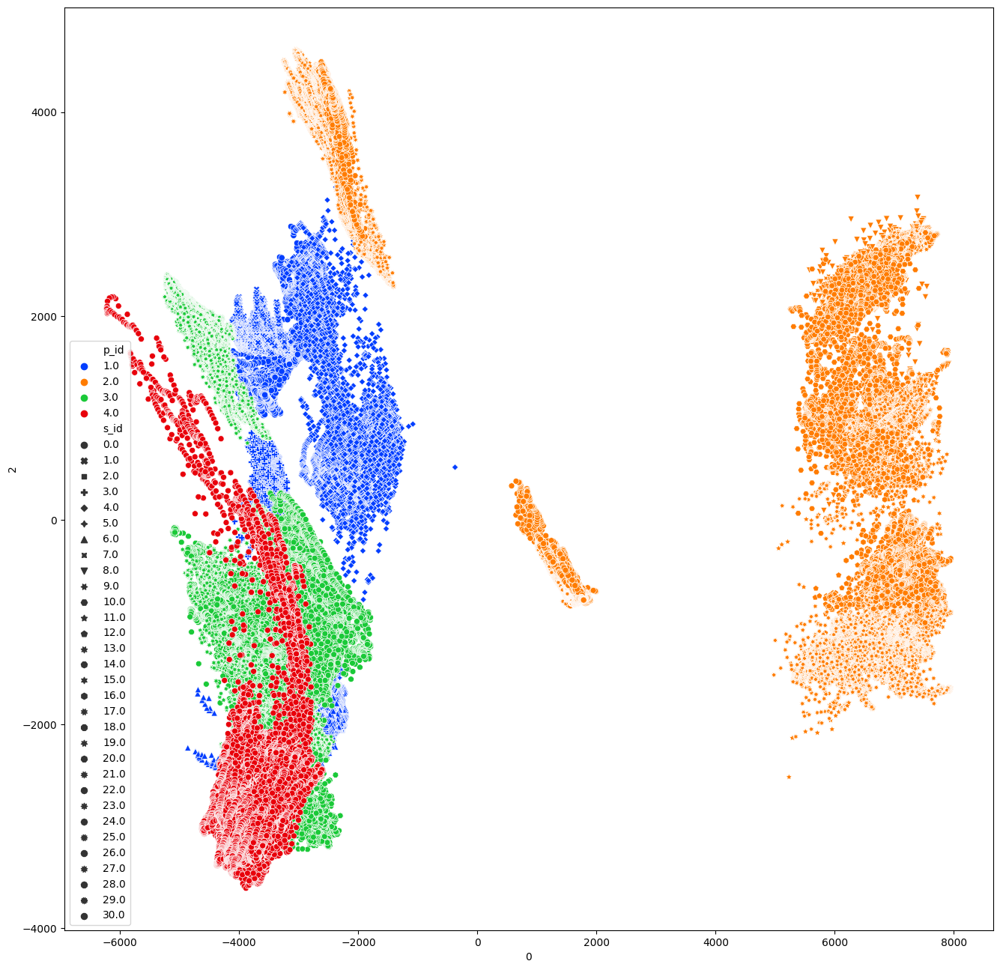

In [15]:
# Визуализация данных
plt.figure(figsize=(16, 16))
scatter = sns.scatterplot(
    x=df_pca[0], y=df_pca[2],
    data=df_pca, hue='p_id',
    style='s_id', palette='bright'
)
plt.legend(loc="best")
plt.show()

Любопытно, что данные второго пилота — мало того, что разнятся между собой — довольно далеко отстоят от данных остальных пилотов. Посмотрим на подробную визуализацию полученных данных.

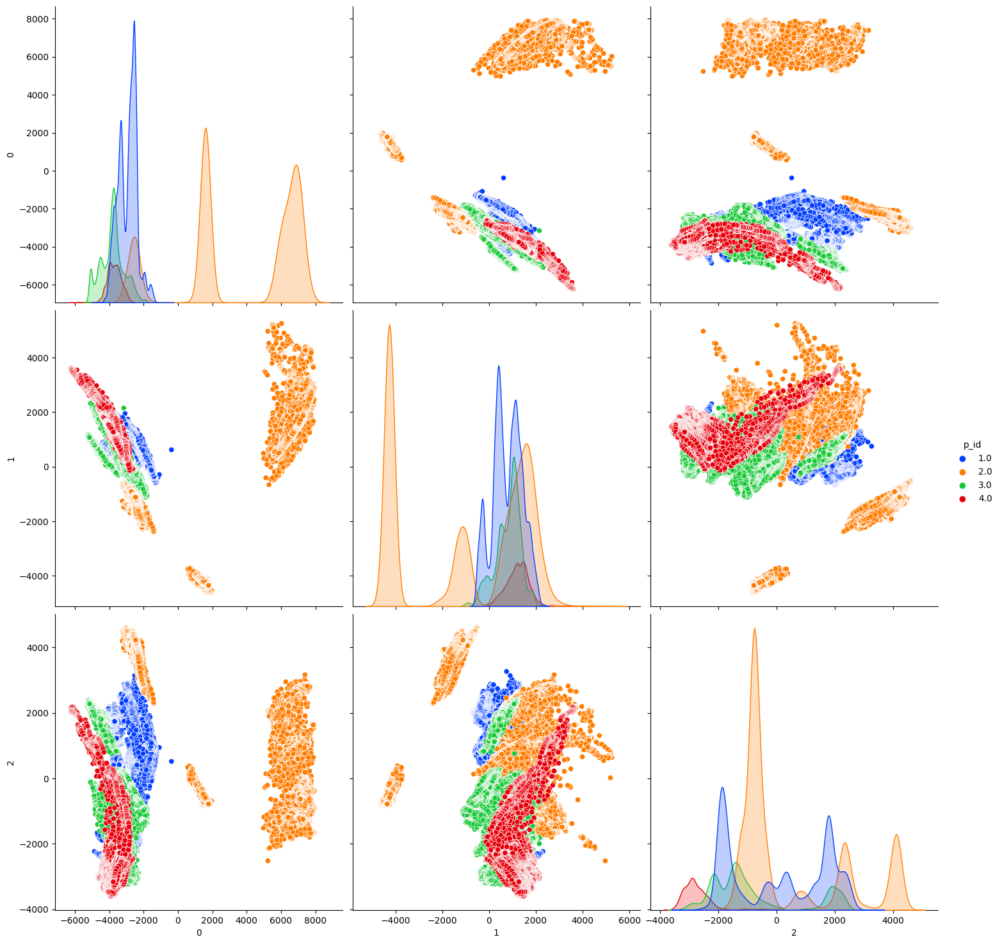

In [50]:
sns.pairplot(
    df_pca.iloc[:, :4], hue='p_id',
    palette='bright', height=5
)
plt.show()

Создается впечатление, что данные первого, третьего и четвертого пилотов имеют между собой больше общего, чем с данными второго пилота. Но даже так, если судить по графикам на главной диагонали, мы можем увидеть довольно маленькую общую зону всех распределений.

На этом перейдем к рассмотрению результатов работы TSNE.

In [72]:
# %%time
# # Создадим объект класса TSNE, уменьшим размерность данных до 3
# tsne = manifold.TSNE(
#     n_components=3, perplexity=50, n_jobs=-1,
#     early_exaggeration=50, random_state=42)
# # Уменьшим размерность данных
# X_reduced_tsne = tsne.fit_transform(data)

CPU times: total: 5h 46min 26s
Wall time: 1h 10min 40s


На обработку данных ушло почти два часа, не мешает сохранить результат в файл.

In [17]:
# Сохраняем обработанные данные в файл 
# np.save('derivatives/reduced_tsne.npy', X_reduced_tsne)

# Подгрузка массива полученных ранее результатов 
X_reduced_tsne_loaded = np.load('derivatives/reduced_tsne.npy')

# Создадим датафрейм из данных
df_tsne = pd.DataFrame(X_reduced_tsne_loaded)
# Создадим переменные меток
df_tsne['pilot_id'] = pd.Series(pilot_id)
df_tsne['set_id'] = pd.Series(set_id)

Построим визуализацию проекции данных на одну из плоскостей.

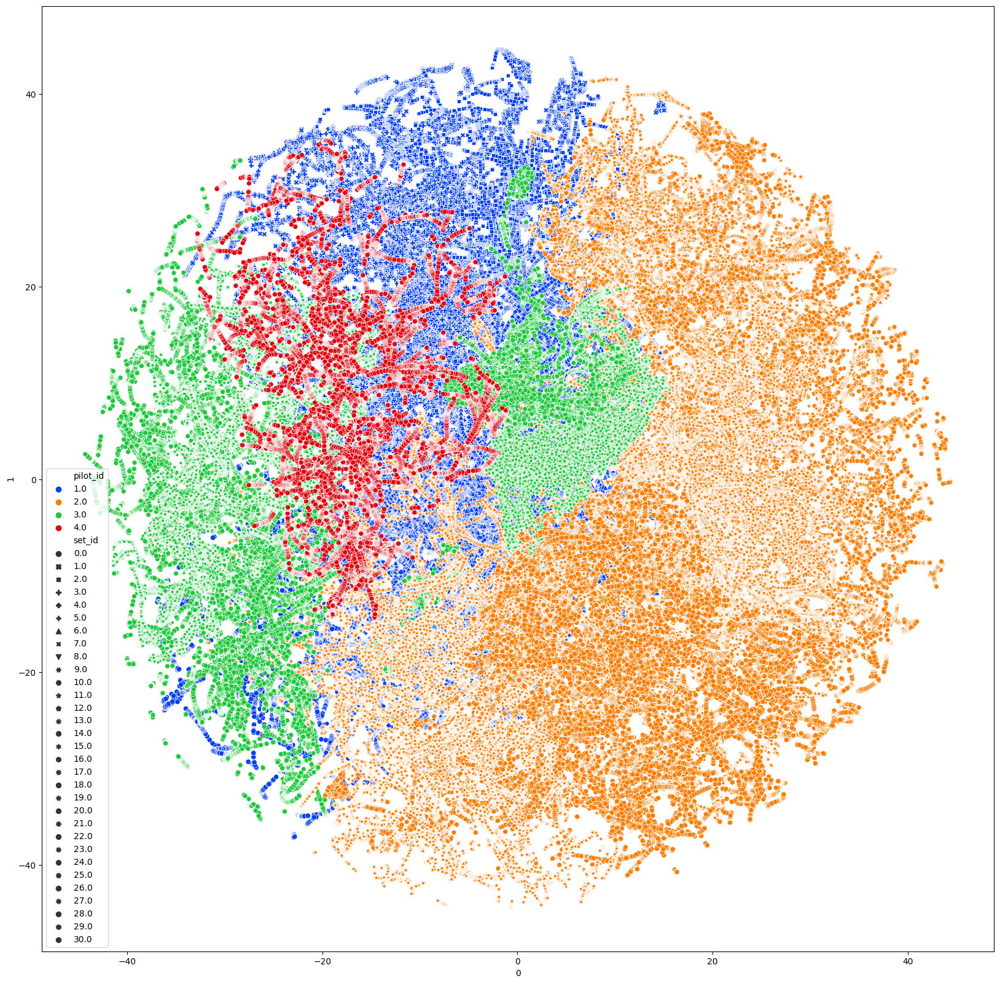

In [18]:
# Визуализация данных
plt.figure(figsize=(20, 20))
scatter = sns.scatterplot(
    x=df_tsne[0], y=df_tsne[1],
    data=df_tsne, hue='pilot_id',
    style='set_id', palette='bright'
)
plt.legend(loc="best")
plt.show()

Мы видим сложную структуру, напоминающую ком переплетенных волокон. Данные первого пилота будто занимают задний план. Данные второго — плотная масса впереди справа. Данные третьего будто разделены. А данные четвертого обрели вид вплетенной сетки. 

Во всяком случае, мы можем без труда определить зоны скопления принадлежащих пилотам данных, т.е. мы не видим салат из сильно перемешанных маркеров, а значит алгоритму все же удается хорошо различать и разграничивать данные — это может быть косвенным предвестником проблем при создании единой общей модели. 

Но, судя по всему, проблемы будут и при создании моделей по пилотам: от сета к сету даже в рамках одного пилота данные могут сильно разниться и располагаться в разных зонах пространства, как это лучше всего видно по третьему пилоту (зеленые маркеры). Также можно видеть плотную зону оранжевых маркеров в секторе на 4-5 часов — если приглядетья (насколько позволяет масштаб рисунка), то можно увидеть, что они имеют другую форму, нежели соседи по цвету. Скорее всего, построить адекватную модель, обученную на данных второго пилота, взятых с разных концов оранжевого облака, будет непросто.

Попробуем теперь добавить вектор классов жестов.

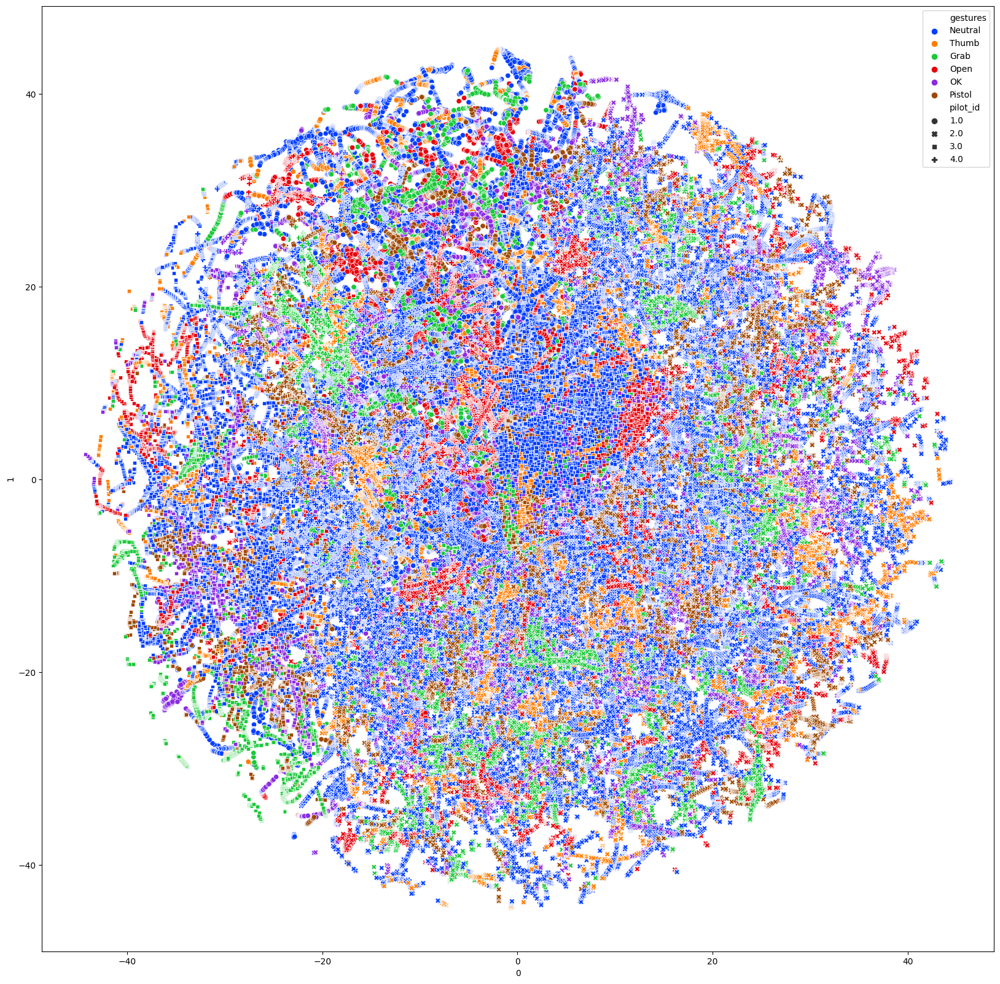

In [33]:
# Получим вектор классов
target = get_target(df_meta)
# Создадим новый признак
df_tsne['gestures'] = target
# Cоздадим список имен жестов
GESTURES = ['Neutral', 'Open', 'Pistol', 'Thumb', 'OK', 'Grab']
# Заменим цифры на имена жестов
df_tsne['gestures'] = df_tsne['gestures'].apply(lambda x: GESTURES[int(x)])

# Визуализация данных
plt.figure(figsize=(20, 20))
scatter = sns.scatterplot(
    x=df_tsne[0], y=df_tsne[1],
    data=df_tsne, hue='gestures',
    style='pilot_id', palette='bright'
)
plt.legend(loc="best")
plt.show()

Вот здесь мы действительно видим *салат*, и это плохо, т.к. одни и те же жесты у разных пилотов, в разных сетах имеют довольно разные характеристики. Идеальная картина — их четкое разделение, явная кластеризация. К сожалению, мы этого не наблюдаем, и этого свидетельствует о сложности задачи создания генеральной модели для для всех пилотов.

Сделаем шаг назад, вернувшись к разделению по пилотам, и посмотрим на более подробную визуализацию.

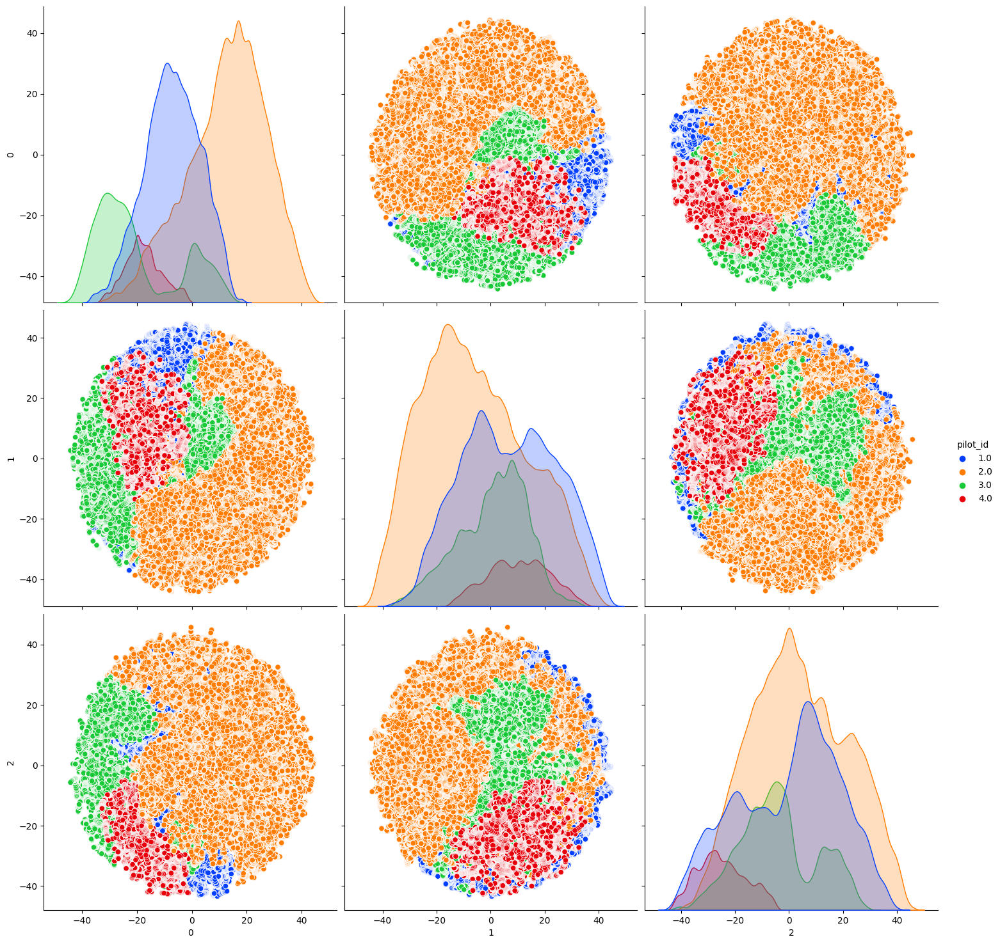

In [51]:
# Визуализация данных
sns.pairplot(
    df_tsne.iloc[:, :4], hue='pilot_id',
    palette='bright', height=5
)
plt.show()

Характер распределений здесь также вызывает сомнения в обобщаемости данных: идеальной картиной было бы полное совпадение распределений, говорящее о том, что жесты одних и тех же классов для всех пилотов имеют одинаковые характеристики. Но этого, разумеется, мы не видим.

Данные третьего пилота будто действительно разделились на два кластера. Наименее плотное распределение имеют данные первого пилота: они и правда будто образовали разреженное облако на заднем плане. Попробуем убрать данные второго и четвертого (с ним все более менее понятно) пилотов, чтобы рассмотреть его получше.

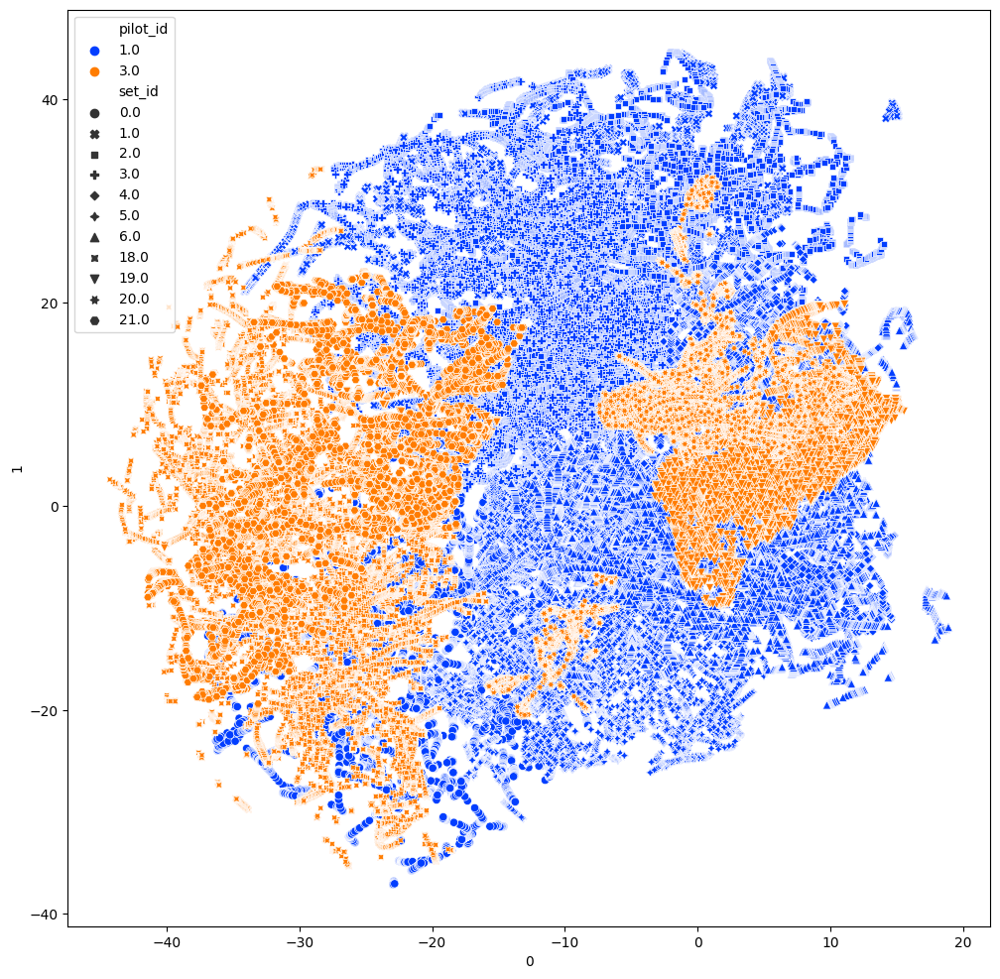

In [25]:
# Извлекаем выборку без данных второго и четвертого пилотов
df_tsne_wo24 = df_tsne.query("pilot_id not in [2, 4]")

# Визуализация данных
plt.figure(figsize=(12, 12))
scatter = sns.scatterplot(
    x=df_tsne_wo24[0], y=df_tsne_wo24[1],
    data=df_tsne_wo24, hue='pilot_id',
    style='set_id', palette='bright'
)
plt.legend(loc="best")
plt.show()

Данные первого пилота действительно занимали довольно немало пространства на заднем плане, однако центр изображения здесь смещен влево, т.к. облако данных второго пилота справа отсутствует. Данные третьего пилота, оказывается, разделены более чем на два кластера.

Далее мы рассмотрим данные каждого из трех пилотов с числом наборов данных больше одного (т.е. исключая четвертого пилота) с окрашиваниям по сетам и по классам жестов.

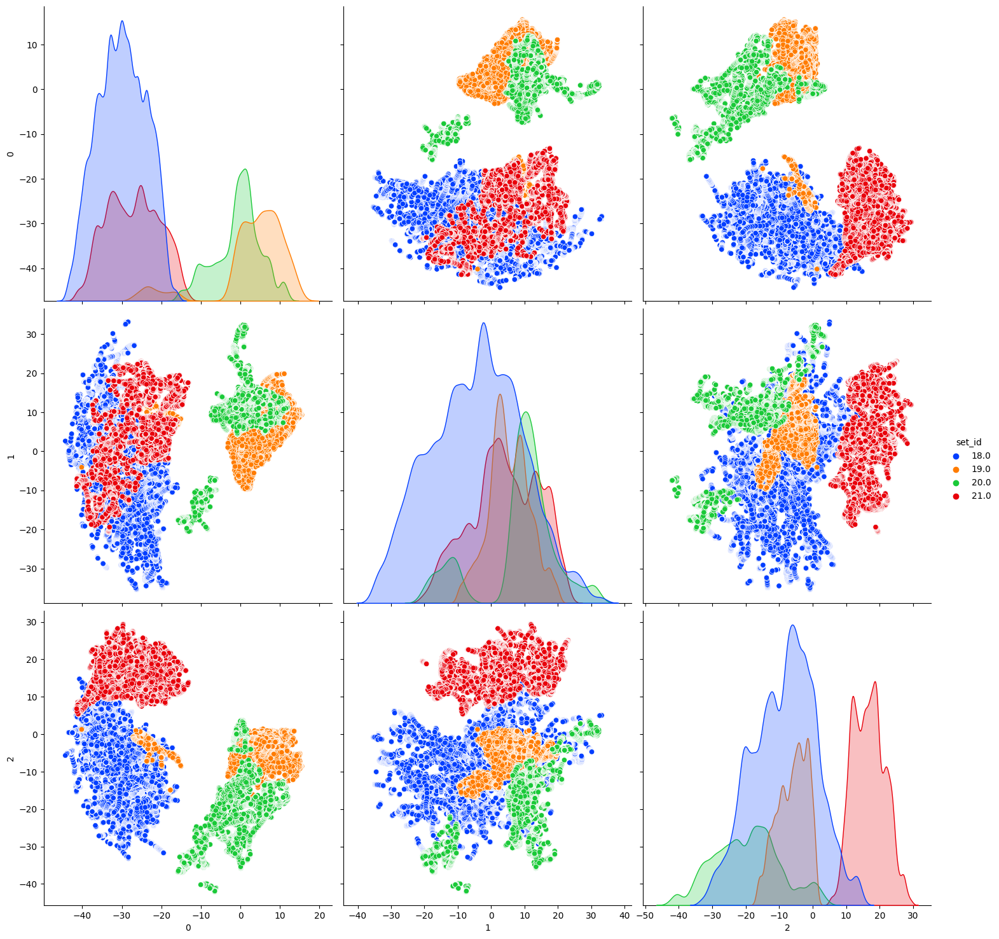

In [52]:
# Извлекаем выборку без данных первого, второго и четвертого пилотов
df_tsne_wo124 = df_tsne.query("pilot_id not in [1, 2, 4]")

# Визуализация данных
sns.pairplot(
    df_tsne_wo124[[0, 1, 2, 'set_id']], hue='set_id',
    palette='bright', height=5
)
plt.show()

Здесь мы наблюдаем даже разделение данных внутри сета — набор данных под индексом 20 разбит на кластеры. Что-то похожее мы наблюдаем и за 19-м сетом. Однако модели обученные на них имеют большую разницу в качестве.

In [40]:
# Разукрасим таблицуу для облегчения восприятия
report.query("pilote_id == 3").style.background_gradient(
    cmap='coolwarm',
    vmin=0, vmax=1,
    subset=list(report.columns)[2:]
)

,file,pilote_id,Corr,corr_a,corr_b,f1_test,Neutral,Open,Pistol,Thumb,OK,Grab
18,2023-04-18_19-08-47 gestures train,3,0.229062,0.265722,0.253171,0.871272,0.914467,0.748824,0.905958,0.585603,0.874290,0.936460
19,2023-05-07_16-54-27,3,0.287033,0.226872,0.270529,0.668066,0.706349,0.356646,0.778718,0.476667,0.627717,0.812627
20,2023-05-07_15-19-05,3,0.105354,0.080947,0.126779,0.904592,0.940323,0.968074,0.895643,0.606398,0.875000,0.928939
21,2023-05-12_19-17-00,3,0.338459,0.317733,0.347011,0.883454,0.914489,0.842324,0.745814,0.890595,0.807018,0.919708


Как видим, `f1_test` 20-го набора является наивысшим: быть может, здесь разница сигналов о разных жестах выше.

Сравним его с наихудшим 19-м.

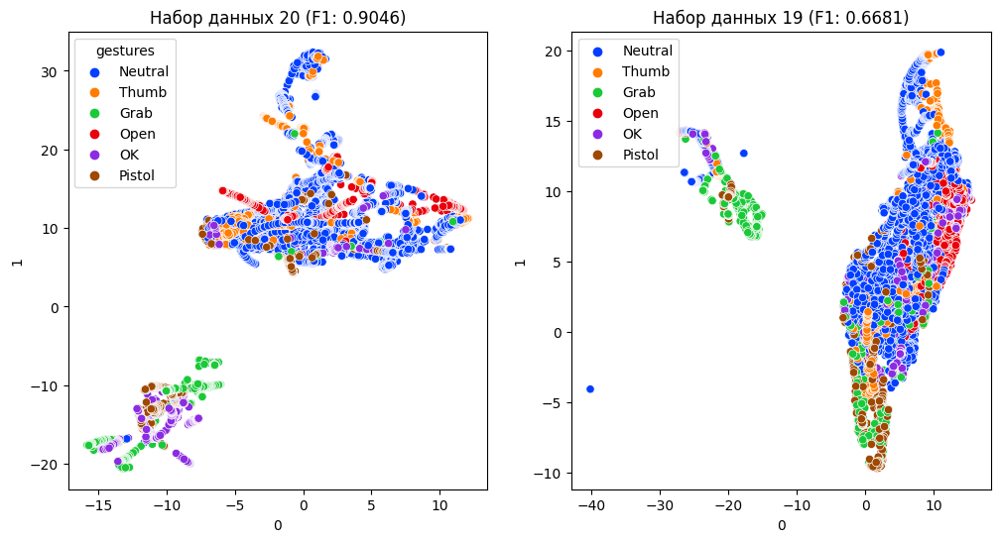

In [73]:
df_tsne_wo124_20 = df_tsne_wo124.query("set_id == 20")
df_tsne_wo124_19 = df_tsne_wo124.query("set_id == 19")

# Визуализация данных
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
scatter1= sns.scatterplot(
    x=df_tsne_wo124_20[0], y=df_tsne_wo124_20[1],
    data=df_tsne_wo124_20, hue='gestures',
    palette='bright', ax=ax[0]
)
ax[0].set_title('Набор данных 20 (F1: 0.9046)')
scatter2 = sns.scatterplot(
    x=df_tsne_wo124_19[0], y=df_tsne_wo124_19[1],
    data=df_tsne_wo124_19, hue='gestures',
    palette='bright', ax=ax[1]
)
ax[1].set_title('Набор данных 19 (F1: 0.6681)')
plt.legend(loc="best")
plt.show()

F1 для Thumb по 20-у сету всего 0.6: и мы будто даже видим, почему могло так произойти — оранжевые шарики разбросаны по верхнему кластеру с наименьшим порядком. Neutral будто и формирует основу верхнего кластера. Open имеет некоторый порядок в разбросе точек — они будто сливаются в бусинки: что-то подобное мы видели, например, для данных четвертого пилота (почти все алгоритмы получали на них отличные модели).

Также надо отметить класс Grab, преимущественно сосредоточенный в нижнем кластере. Класс OK имеет вторую минимальную метрику (0.875), видимо, потому что расположился в обоих кластерах. Pistol, например, этим грешит чуть меньше.

В 19-м сете Pistol, Grab, OK и Neutral присутствуют в обоих кластерах, однако их метрики выше, чем у Open с Thumb, смешанных с остальными в большом кластере. Open довольно сильно смешался с Neutral и включил в свой миникластер данные OK.

Таким же образом можно рассмотреть все сеты всех пилотов, однако это заняло бы у нас много времени, т.ч. мы перейдем к первому пилоту.

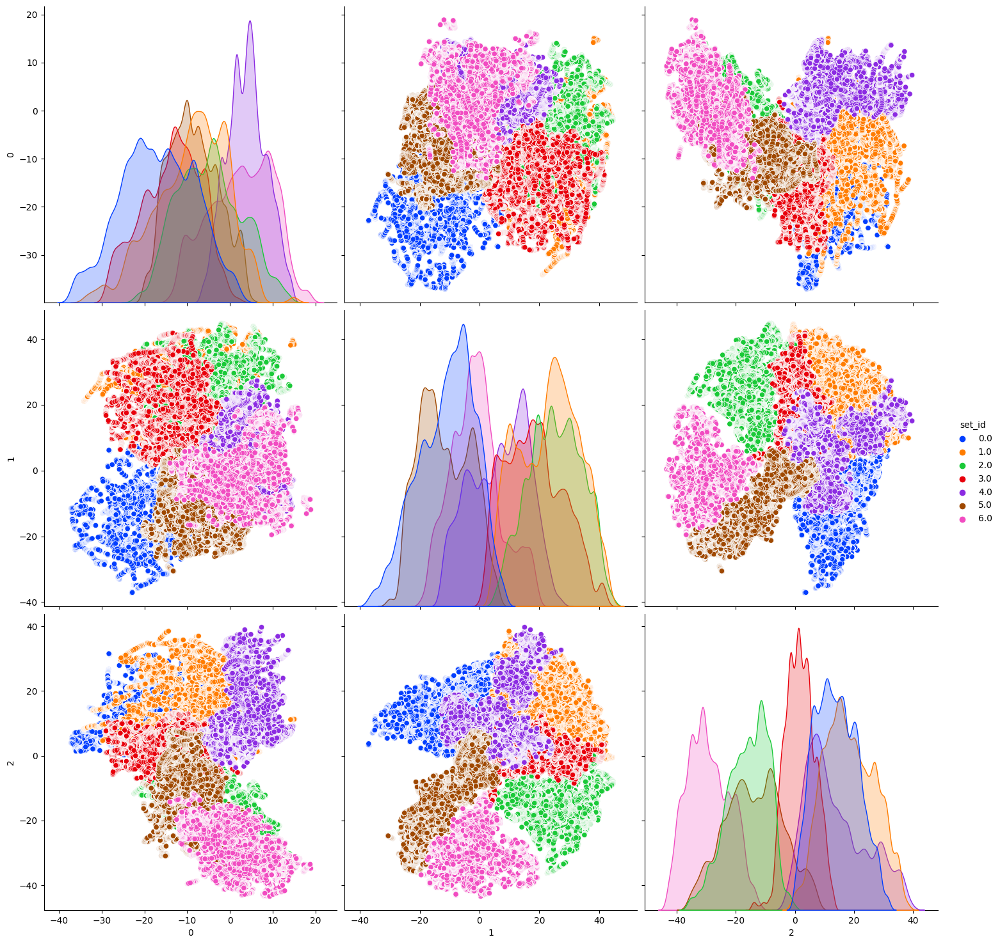

In [49]:
# Извлекаем выборку без данных первого, второго и четвертого пилотов
df_tsne_wo234 = df_tsne.query("pilot_id not in [2, 3, 4]")

# Визуализация данных
sns.pairplot(
    df_tsne_wo234[[0, 1, 2, 'set_id']], hue='set_id',
    palette='bright', height=5
)
plt.show()

Данные сетов не сказать что сильно перемешаны, хотя в идеале мы ожидаем увидеть обратное: высокая степень смешения сетов и четкая кластеризация данных по классам жестов.

In [55]:
# Разукрасим таблицуу для облегчения восприятия
report.query("pilote_id == 1").style.background_gradient(
    cmap='coolwarm',
    vmin=0, vmax=1,
    subset=list(report.columns)[2:]
)

,file,pilote_id,Corr,corr_a,corr_b,f1_test,Neutral,Open,Pistol,Thumb,OK,Grab
0,2023-05-15_16-16-08,1,0.274356,0.412871,0.256877,0.833128,0.902053,0.919192,0.641727,0.307978,0.779570,0.897368
1,2023-05-15_17-12-24,1,0.020546,0.191707,0.023858,0.636806,0.766574,0.801498,0.212488,0.068650,0.363144,0.572864
2,2023-06-05_16-12-38,1,0.341675,0.448190,0.339225,0.660268,0.818091,0.776025,0.271523,0.000000,0.560907,0.596623
3,2023-06-05_17-53-01,1,0.353172,0.264307,0.413203,0.746547,0.834416,0.785276,0.680973,0.373757,0.643200,0.644118
4,2023-06-20_14-43-11,1,0.083280,0.179436,0.182742,0.703648,0.811977,0.809892,0.452763,0.321569,0.633562,0.545151
5,2023-06-20_13-30-15,1,0.274443,0.235754,0.382149,0.753380,0.823946,0.830688,0.416510,0.519573,0.748538,0.776642
6,2023-06-20_12-34-17,1,0.361622,0.414341,0.356253,0.753033,0.846345,0.846154,0.692982,0.067183,0.714514,0.788945


Посмотрим на наихудший (с индексом 1) и наилучший (с индексом 0).

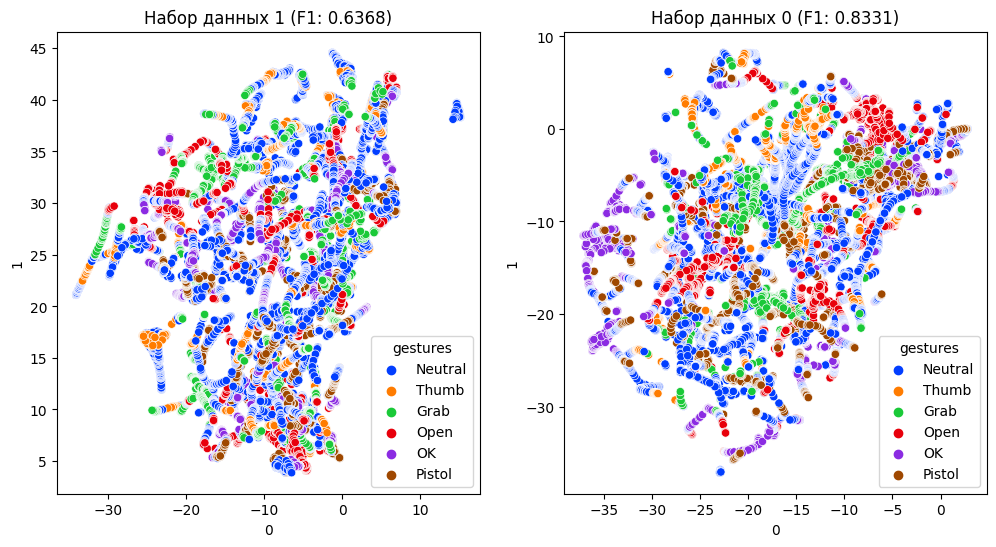

In [72]:
df_tsne_wo234_1 = df_tsne_wo234.query("set_id == 1")
df_tsne_wo234_0 = df_tsne_wo234.query("set_id == 0")

# Визуализация данных
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
scatter1 = sns.scatterplot(
    x=df_tsne_wo234_1[0], y=df_tsne_wo234_1[1],
    data=df_tsne_wo234_1, hue='gestures',
    palette='bright', ax=ax[0]
)
ax[0].set_title('Набор данных 1 (F1: 0.6368)')
scatter2 = sns.scatterplot(
    x=df_tsne_wo234_0[0], y=df_tsne_wo234_0[1],
    data=df_tsne_wo234_0, hue='gestures',
    palette='bright', ax=ax[1]
)
ax[1].set_title('Набор данных 0 (F1: 0.8331)')
plt.show()

Да, мы видим бусинки данных, но часто они состоят из разноцветных маркеров, что и может свидетельствовать о плохой различимости. Справа будто наблюдается более строгий порядок.

Перейдем к данным второго пилота.

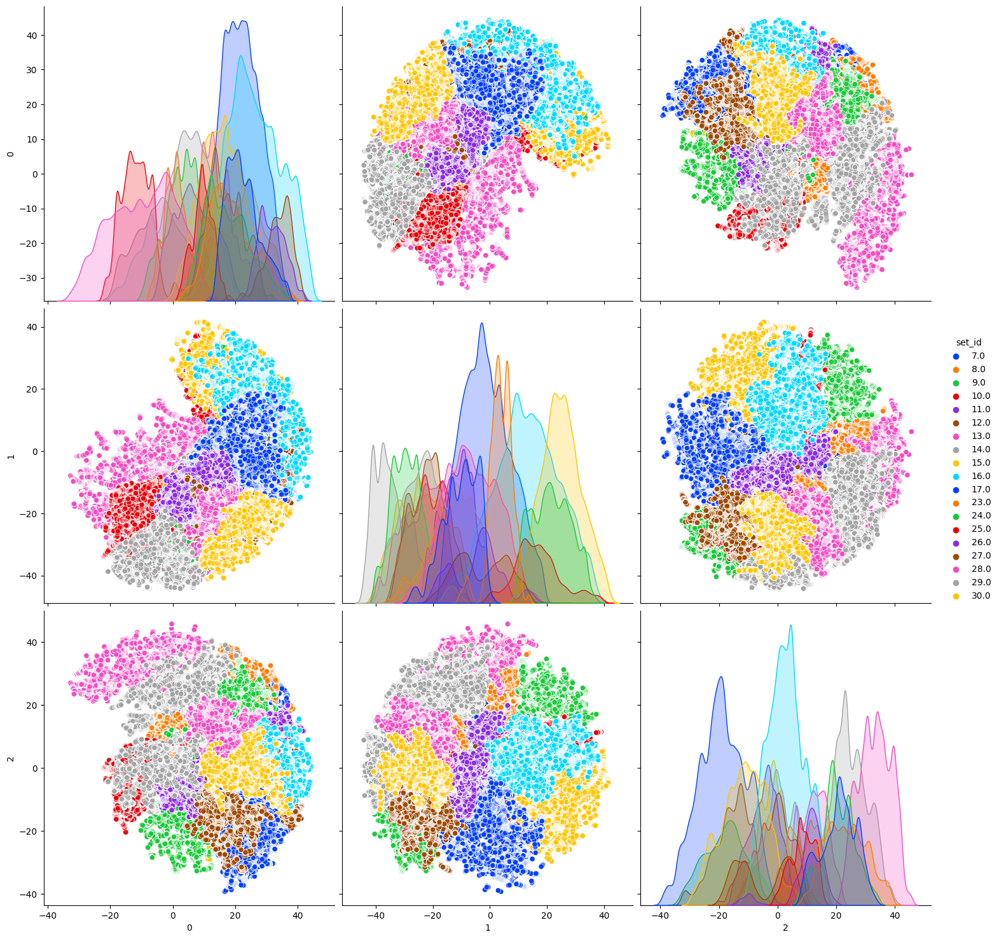

In [57]:
# Извлекаем выборку без данных первого, второго и четвертого пилотов
df_tsne_wo134 = df_tsne.query("pilot_id not in [1, 3, 4]")

# Визуализация данных
sns.pairplot(
    df_tsne_wo134[[0, 1, 2, 'set_id']], hue='set_id',
    palette='bright', height=5
)
plt.show()

Здесь мы также наблюдаем аналогичную картину: хорошее различение сетов. Отдельный интерес представляют также распределения значений переменных — не хор, а гомон. Однако при должном усердии можно отыскать среди них такие, распределение значений которых более менее совпадают — в случае со вторым пилотом это сделать легче, т.к. наборов данных на него больше.

In [58]:
# Разукрасим таблицуу для облегчения восприятия
report.query("pilote_id == 2").style.background_gradient(
    cmap='coolwarm',
    vmin=0, vmax=1,
    subset=list(report.columns)[2:]
)

,file,pilote_id,Corr,corr_a,corr_b,f1_test,Neutral,Open,Pistol,Thumb,OK,Grab
7,2023-09-30_08-06-44,2,0.400822,0.443222,0.358299,0.907203,0.931129,0.882283,0.845927,0.946067,0.782946,0.913140
8,2023-09-29_11-03-50,2,0.346494,0.384182,0.456843,0.920865,0.936647,0.901176,0.922910,0.941950,0.840376,0.886878
9,2023-09-29_09-20-47,2,0.271879,0.363008,0.308670,0.924883,0.940181,0.897527,0.924319,0.915292,0.902386,0.877990
10,2023-09-13_22-14-05,2,0.243653,0.187570,0.295579,0.895726,0.923163,0.773723,0.875502,0.913043,0.857143,0.867368
11,2023-09-12_14-59-23,2,0.096293,0.083346,0.138096,0.833654,0.862467,0.792291,0.838095,0.797909,0.759907,0.779528
12,2023-09-12_12-55-22,2,0.235763,0.196508,0.202825,0.920092,0.936680,0.879650,0.892000,0.907563,0.898678,0.908350
13,2023-05-31_17-14-41,2,0.253933,0.359149,0.347458,0.884248,0.913714,0.932584,0.929054,0.481149,0.881801,0.927690
14,2023-05-31_15-46-37,2,0.181732,0.269111,0.236196,0.911735,0.938925,0.933078,0.922034,0.714286,0.796715,0.944056
15,2023-05-22_20-22-01,2,0.267330,0.307690,0.193182,0.895452,0.925156,0.911591,0.847784,0.891228,0.772152,0.788427
16,2023-05-22_17-04-29,2,0.247039,0.366366,0.292573,0.925522,0.948345,0.863388,0.851948,0.934699,0.873711,0.900783


Особенно выделяются 23-й и 29-й сеты: они хуже всех. Осмотрим 23-й, а также 16-й (наилучший).

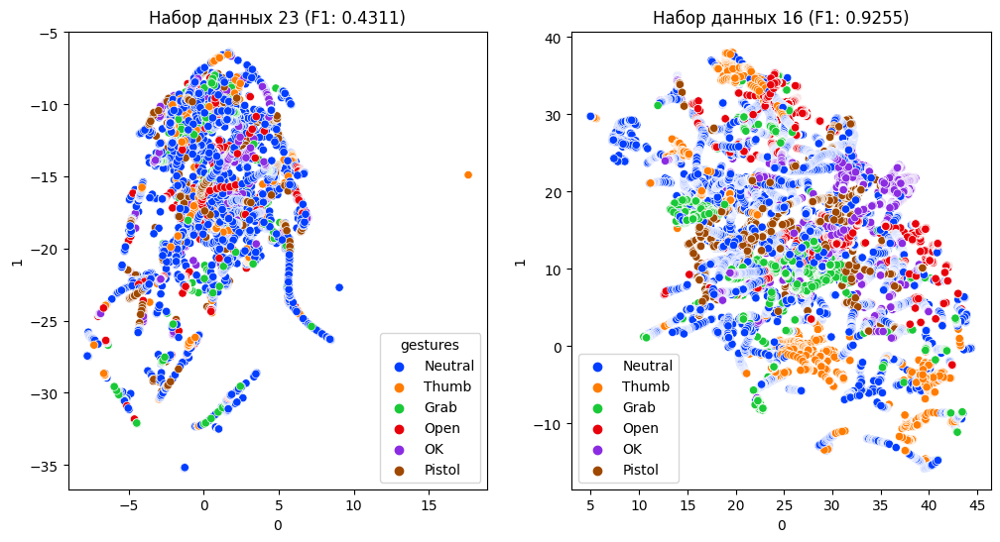

In [74]:
df_tsne_wo134_23 = df_tsne_wo134.query("set_id == 23")
df_tsne_wo134_16 = df_tsne_wo134.query("set_id == 16")

# Зададим фигуру и поля
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
scatter1 = sns.scatterplot(
    x=df_tsne_wo134_23[0], y=df_tsne_wo134_23[1],
    data=df_tsne_wo134_23, hue='gestures',
    palette='bright', ax=ax[0]
)
ax[0].set_title('Набор данных 23 (F1: 0.4311)')
scatter2 = sns.scatterplot(
    x=df_tsne_wo134_16[0], y=df_tsne_wo134_16[1],
    data=df_tsne_wo134_16, hue='gestures',
    palette='bright', ax=ax[1]
)
ax[1].set_title('Набор данных 16 (F1: 0.9255)')
plt.legend(loc="best")
plt.show()

Мы видим большую плотность точек на левом графике. Более этого, пожалуй, ничего и скажешь. Ну, может быть, еще добавить, что график справа кажется более разноцветным.

Присмотримся к данным получше.

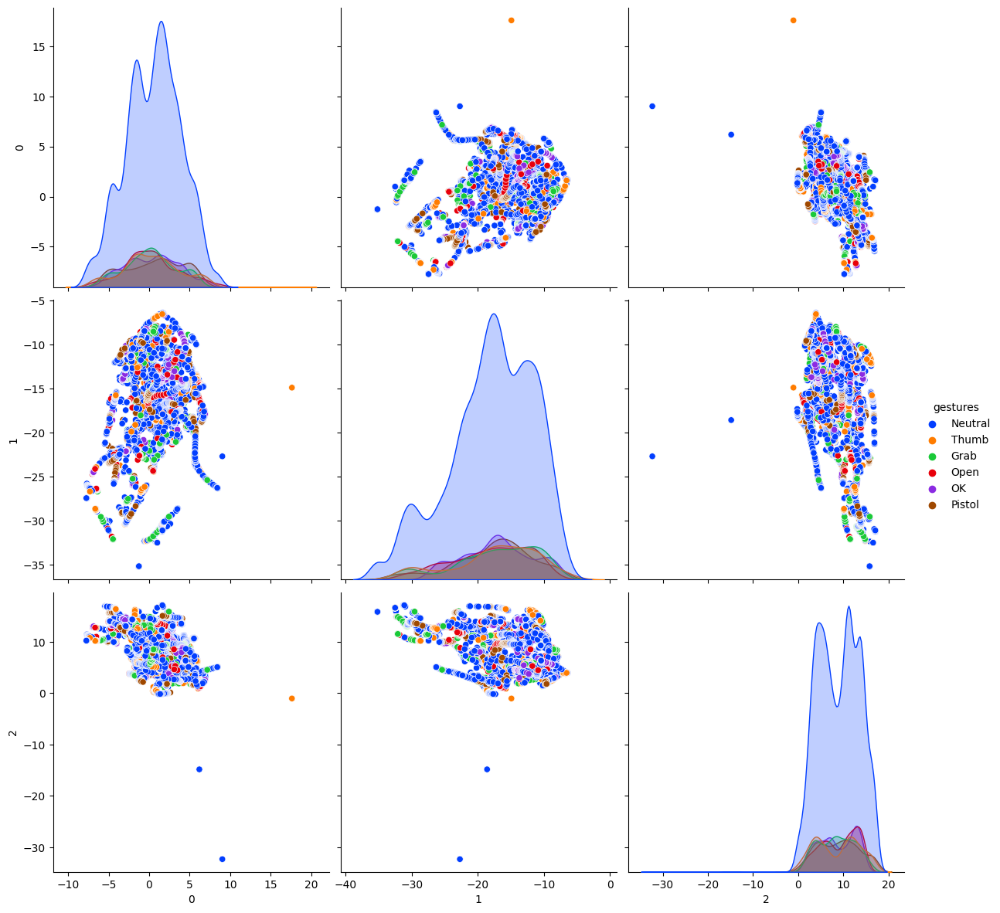

In [66]:
# Визуализация данных
sns.pairplot(
    df_tsne_wo134_23[[0, 1, 2, 'gestures']],
    hue='gestures', palette='bright', height=4
)
plt.show()

Очень плохо: распределения значений сошлись и смешались. Как мы это уже отмечали, на уровне жестов лучше всего тогда, когда данные отличаются. На уровне сетов и пилотов хорошо, если распределения совпадают.

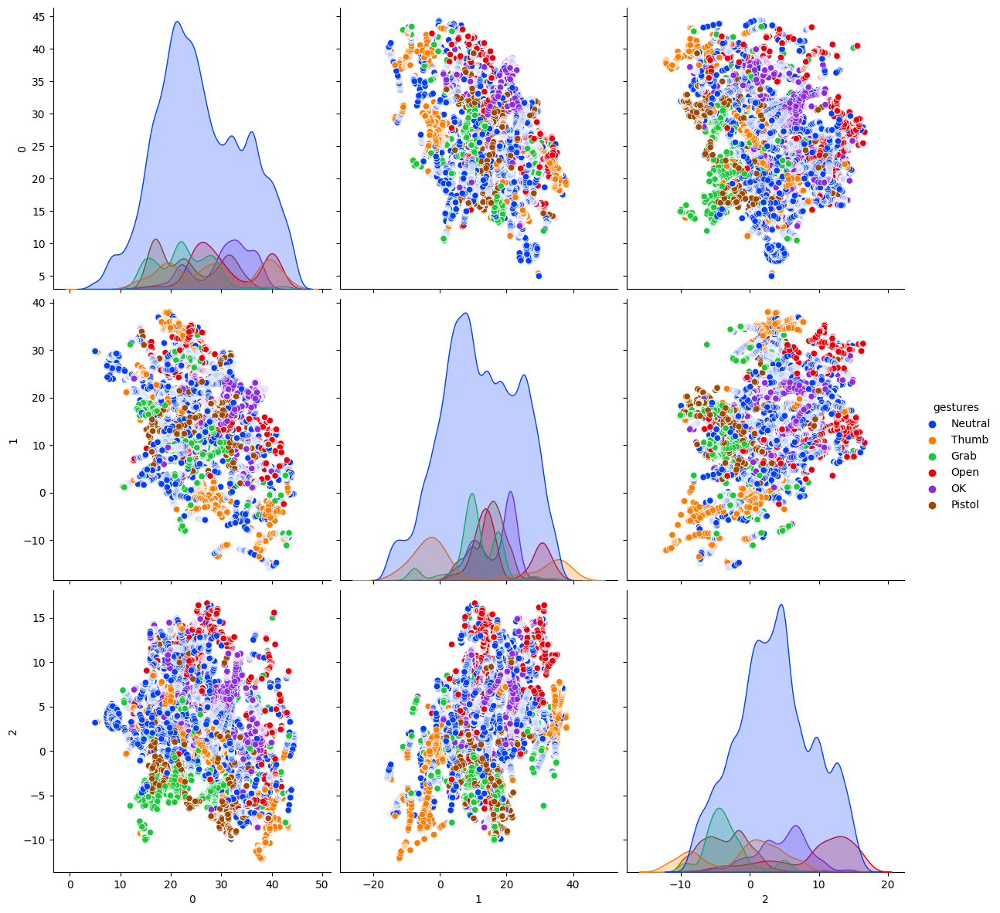

In [67]:
# Визуализация данных
sns.pairplot(
    df_tsne_wo134_16[[0, 1, 2, 'gestures']],
    hue='gestures', palette='bright', height=4
)
plt.show()

На этот раз ситуация лучше. Распределения не сошлись. Да, нейтраль накрыла практически всех, но это нормально, т.к. именно этот класс является размежевающим: выполняемые операторами жесты чередуются с *жестом* нейтрального состояния руки, что уводит сигналы о *затуханиях* жестов в вотчину нейтрального класса.

Напоследок посмотрим на то, как выглядят данные сжатые в 2d. 

In [75]:
# %%time
# # Создадим объект класса TSNE, уменьшим размерность данных до 2
# tsne_2d = manifold.TSNE(
#     n_components=2, perplexity=50, n_jobs=-1,
#     early_exaggeration=50, random_state=42)
# # Уменьшим размерность данных
# X_reduced_tsne_2d = tsne_2d.fit_transform(data)

CPU times: total: 1h 49min 10s
Wall time: 26min 4s


На этот раз алгоритм справился много быстрее.

In [96]:
# Сохраняем обработанные данные в файл 
# np.save('derivatives/reduced_tsne_2d.npy', X_reduced_tsne_2d)
# Подгрузка массива полученных ранее результатов 
X_reduced_tsne_2d_loaded = np.load('derivatives/reduced_tsne_2d.npy')
# Создадим датафрейм из данных
df_tsne_2d = pd.DataFrame(X_reduced_tsne_2d_loaded)
# Создадим переменные меток
df_tsne_2d['pilot_id'] = pd.Series(pilot_id)
df_tsne_2d['set_id'] = pd.Series(set_id).astype('Int16')

Но, чтобы не выводить одно и то же который раз, посмотрим на расположения сетов, включенных нами ранее в выборку метаданных о лучших сетах (наборы данных, на которых удалось создать качественные модели).

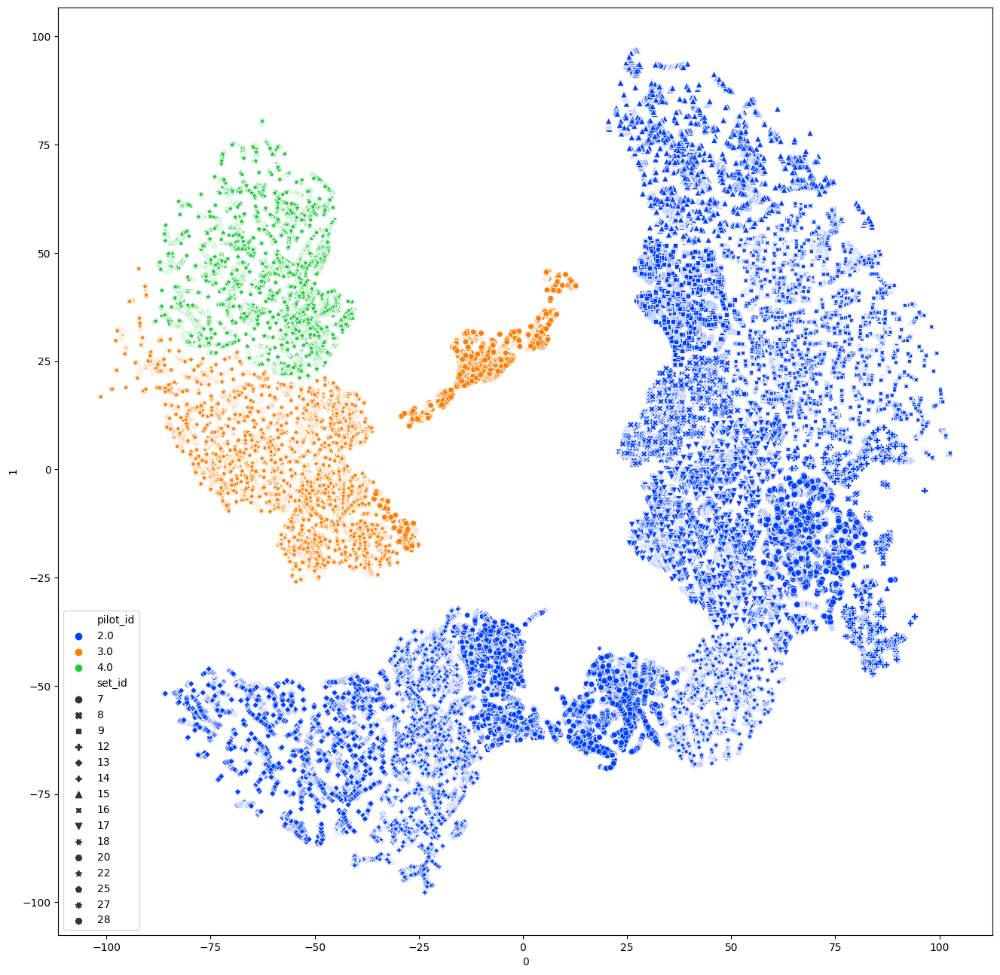

In [114]:
# Сформируем выборку из данных сетов в best_files
df_tsne_2d_best_files = df_tsne_2d[df_tsne_2d['set_id'].isin(list(best_files.index))]

# Визуализация данных
plt.figure(figsize=(16, 16))
scatter = sns.scatterplot(
    x=df_tsne_2d_best_files[0], y=df_tsne_2d_best_files[1],
    data=df_tsne_2d_best_files, hue='pilot_id',
    style='set_id', palette='bright'
)
plt.legend(loc="best")
plt.show()

Пожалуй, ничего нового мы уже сказать не сможем. Есть лишь предположение, что для более качественных данных нужно повысить как площадь охватываемой манжетой поверхности на руке, так и число датчиков на квадратный сантиметр кожи. Возможно, решение также во многом зависит от продвижений в плоскости технической модернизации датчиков.

---
## Выводы

Удалось провести довольно большую предварительную работу над данными. Получилось осуществить прогон данных через 20 разных алгоритмов МО, сформировать метаданные в виде отчетов по каждой модели и собрать сведения о перспективных сетах.

Получилось выявить негативные особенности данных, связанные с изменением характеристик временных рядов в процессе записи сигналов при выполнении жестов: исследование гомогенности выборок показало, что алгоритму МО часто удается довольно неплохо отличать данные из треннировочной выборки от данных из тестовой. Возможно, это говорит о том, что для более качественных измерений необходимо привести пилота с надетой на руку манжетой в некоторое стабилизированное состояние. Или, наоборот, пилот устает выполнять жесты физически, либо начинает терять концентрацию внимания.

Следующая особенность данных состоит в разнородности их характеристик при сравнении между пилотами и даже между сетами одних и тех же пилотов. Также классы жестов плохо поддаются четкой кластеризации, что приводит к их вариативности при совокупном просмотре сетов, т.е. ведомые целью построить общую модель для сетов или для пилотов столкнутся с тем, что одни и те же жесты в разных наборах данных имеют сильно отличающиеся характеристики, что, разумеется, плохо отражается на обобщаемости.

В задаче классификации временных рядов все зависит от качества данных. Изменение положения датчиков во время записи сигналов может сильно подпортить данные. Изменение положения датчиков при повторном закреплении манжеты в ходе новых сеансов записи весьма вероятно сделает новые данные несовместимыми со старыми. И речь может идти буквально о миллиметрах кожного покрова. Усталость пилота, потеря концентрации ведут к необходиомсти перезаписывать сеансы.

Возможно, для достижения более высоких результатов понадобится пересмотреть технологию сбора данных и сменить оптомиографические датчики на электромиографические. Однако я, как сторонний исследователь проблемы, на этом моменте считаю свою свободу на спекуляции исчерпанной.